# PHYS555 - Feb-14-2023 - ML course 
Hossen Teimoorinia

In [1]:
import numpy as np
from sklearn.mixture import GaussianMixture as GMM
%matplotlib inline
import pandas as pd
import os
### import the following modules:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import model_selection as md
from sklearn import preprocessing
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from matplotlib import cm
from sklearn.metrics import roc_curve, auc
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
import itertools
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from pandas.plotting import scatter_matrix    
from sklearn.neighbors import KNeighborsRegressor
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split
from sklearn import linear_model
import sys
from sklearn.neighbors import KNeighborsClassifier
from scipy.interpolate import interp1d
from matplotlib import pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt
from sklearn import datasets, metrics, model_selection, svm
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
print('Done!')

Done!


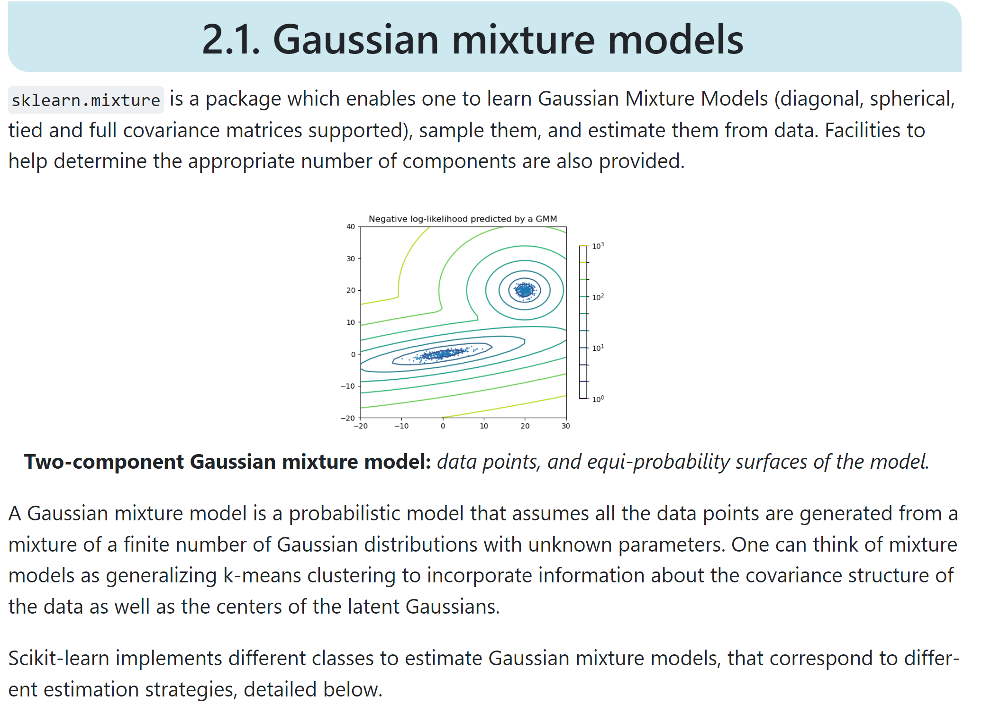

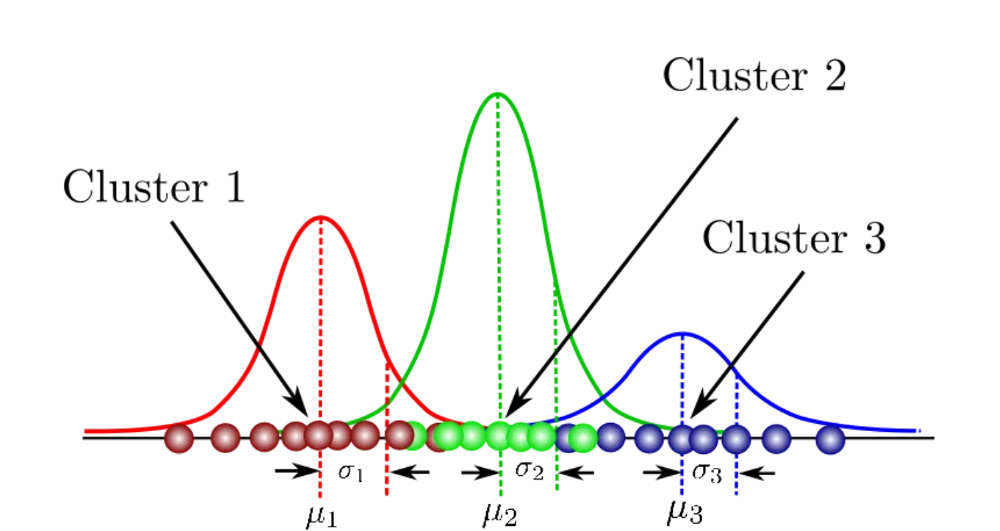
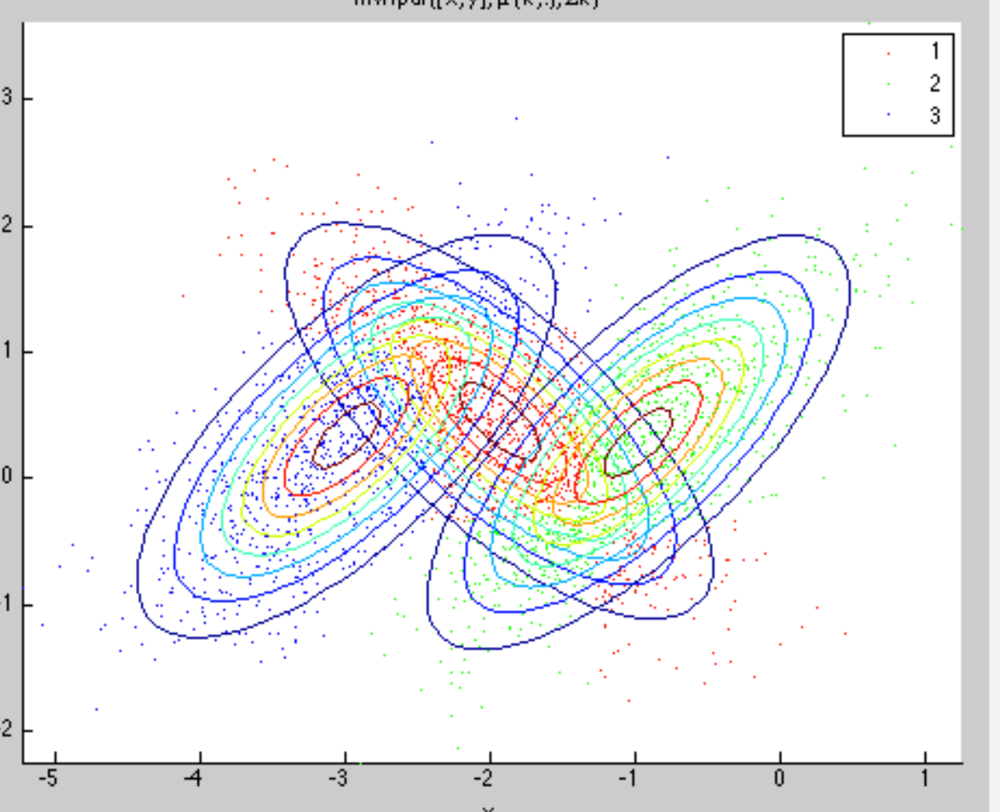
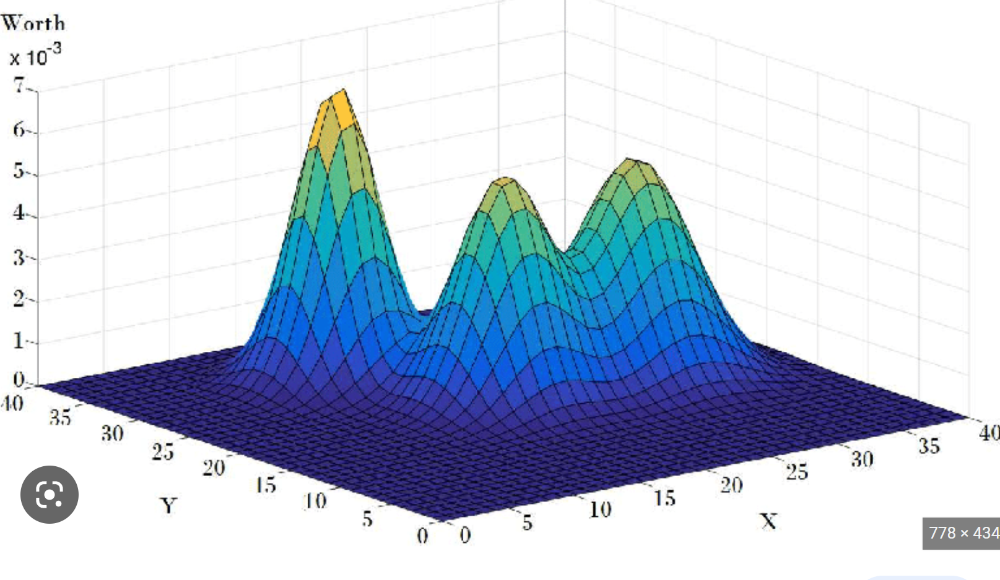
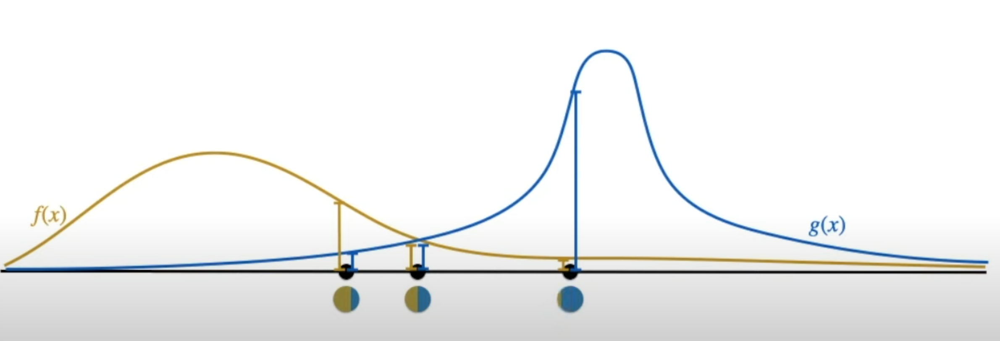

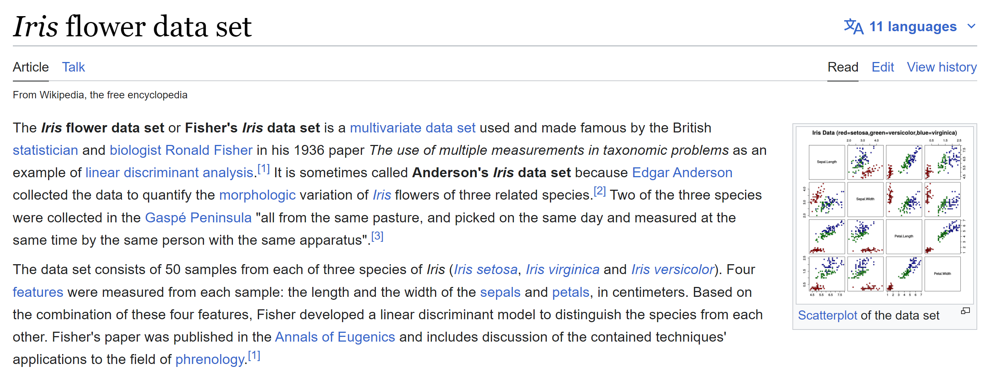
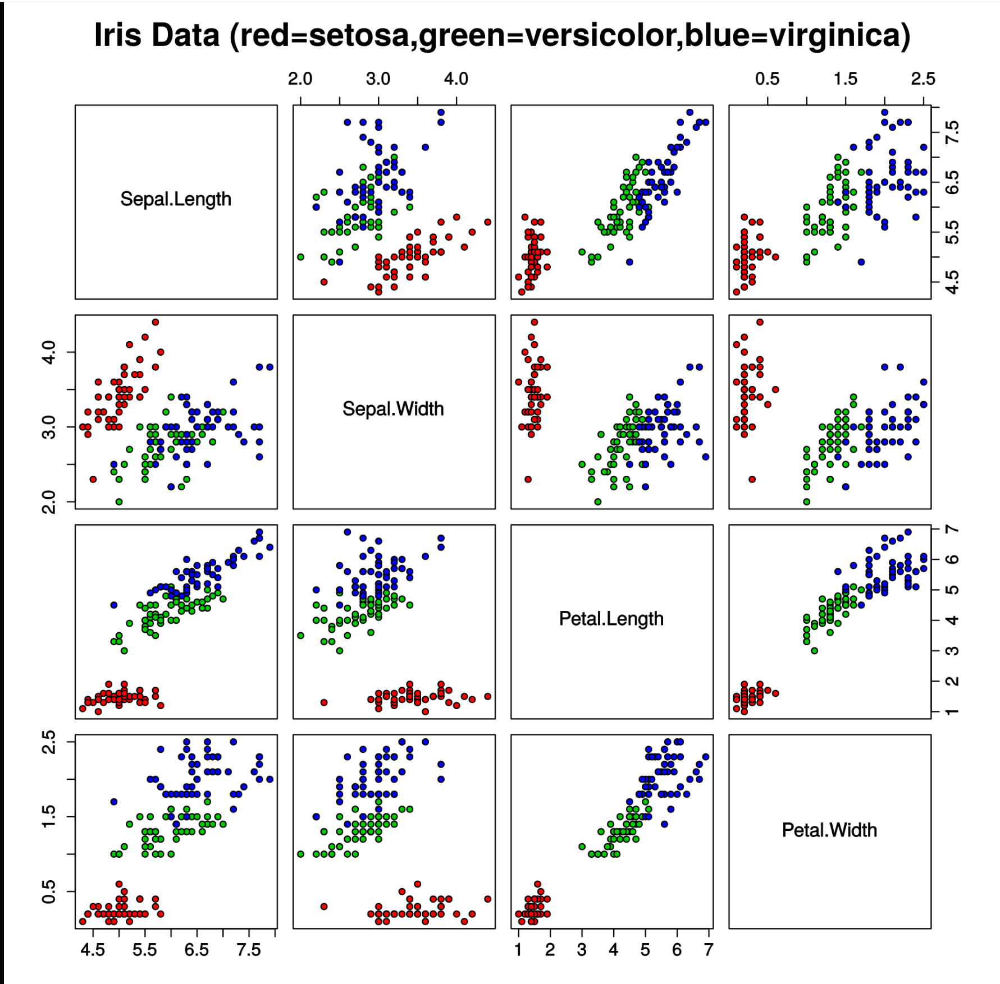

In [2]:
import seaborn as sns

iris = sns.load_dataset("iris")

iris.info()
iris.head(200)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sepal_length  150 non-null    float64
 1   sepal_width   150 non-null    float64
 2   petal_length  150 non-null    float64
 3   petal_width   150 non-null    float64
 4   species       150 non-null    object 
dtypes: float64(4), object(1)
memory usage: 6.0+ KB


,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


# ---------------------------------------- seaborn Examples
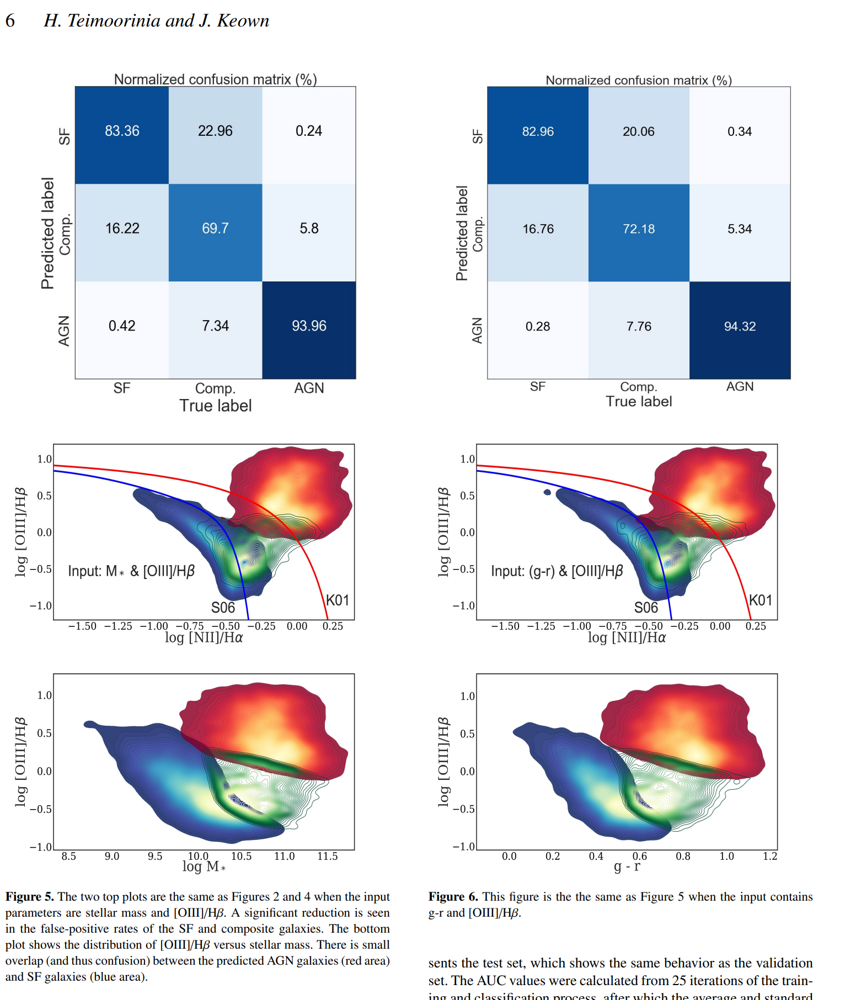
# ---------------------------------------- 

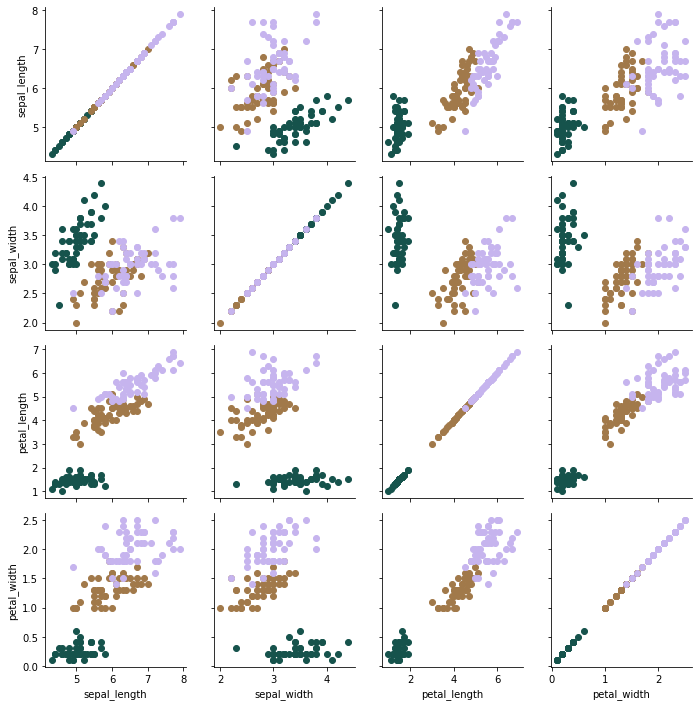

In [3]:
g = sns.PairGrid(iris, hue="species", 
                 palette=sns.color_palette("cubehelix", 3), 
                 vars=['sepal_length','sepal_width',
                       'petal_length','petal_width'])
g.map(plt.scatter)
plt.show()

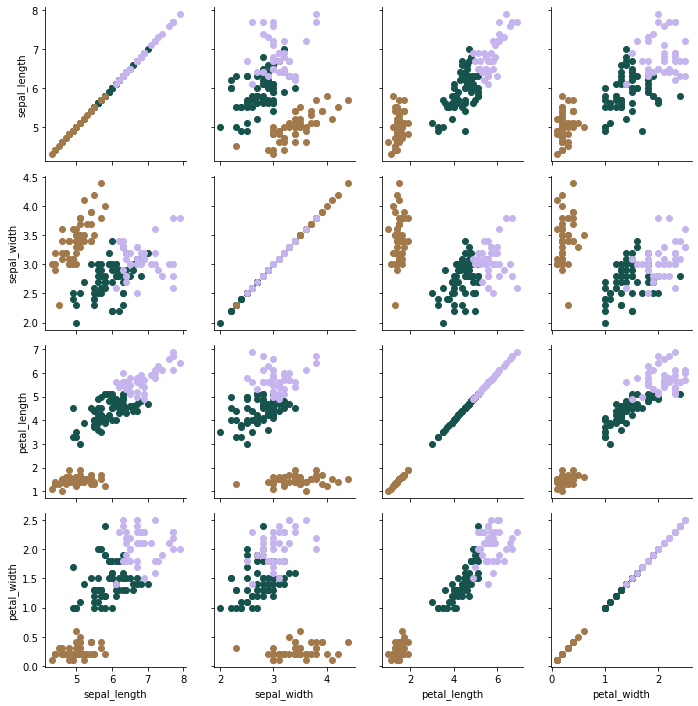

In [4]:
kmeans_iris = KMeans(n_clusters=3)
pred_kmeans_iris = kmeans_iris.fit_predict(iris[['sepal_length',
                                                 'sepal_width',
                                                 'petal_length',
                                                 'petal_width']])

iris['kmeans_pred'] = pred_kmeans_iris

g = sns.PairGrid(iris, hue="kmeans_pred", 
                 palette=sns.color_palette("cubehelix", 3), 
                 vars=['sepal_length','sepal_width',
                       'petal_length','petal_width'])
g.map(plt.scatter)
plt.show()


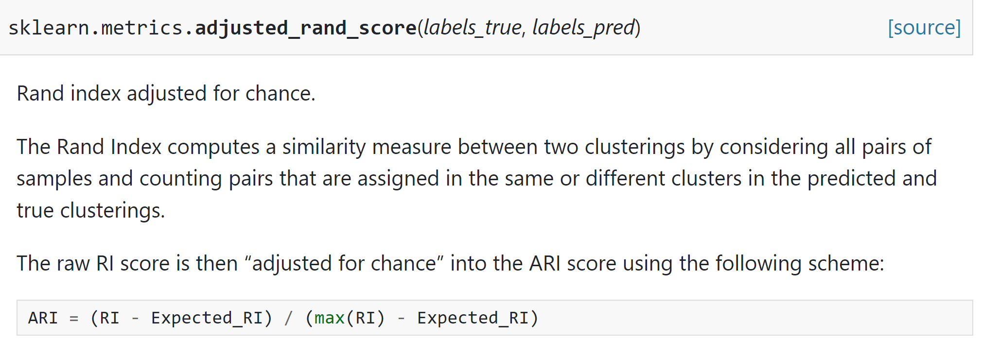

In [5]:
from sklearn.metrics import adjusted_rand_score

iris_kmeans_score = adjusted_rand_score(iris['species'], 
                                        iris['kmeans_pred'])
round(iris_kmeans_score,3)

0.73

In [6]:
gmm_iris = GaussianMixture(n_components=3).fit(iris[['sepal_length',
                                                     'sepal_width',
                                                     'petal_length',
                                                     'petal_width']])
pred_gmm_iris = gmm_iris.predict(iris[['sepal_length',
                                       'sepal_width',
                                       'petal_length',
                                       'petal_width']])

iris['gmm_pred'] = pred_gmm_iris

iris_gmm_score = adjusted_rand_score(iris['species'], 
                                     iris['gmm_pred'])

round(iris_gmm_score,3)

0.904

In [7]:
inp_alfa= np.load('inp_alfalfa.npy')
inp_tar= np.load('tar_alfalfa.npy')


X_tr,X_va,Y_tr, Y_va = train_test_split(inp_alfa,inp_tar ,test_size=0.25 )

print ('training set == ',np.shape(X_tr),np.shape(Y_tr),',, validation set == ', np.shape(X_va),np.shape(Y_va))


scaler_S= StandardScaler().fit(X_tr)  # line #2
X_tr_N= scaler_S.transform(X_tr) # line # 3

X_va_N= scaler_S.transform(X_va)  # Line #4

print('Done!')

training set ==  (10255, 15) (10255,) ,, validation set ==  (3419, 15) (3419,)
Done!


In [8]:
gmm_alfa = GaussianMixture(n_components=2).fit(X_tr_N)
XPP_tr=gmm_alfa.predict_proba(X_tr_N)  # predictions for tr, probability
XP_tr=gmm_alfa.predict(X_tr_N)         # predeictions fro tr, hard clusterinh    

XPP_va=gmm_alfa.predict_proba(X_va_N)   # predictions for va, probability
XP_va=gmm_alfa.predict(X_va_N)          # predictions for va, probability


(array([3027.,   69.,   68.,   51.,   67.,   55.,   68.,   91.,  177.,
        1452.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

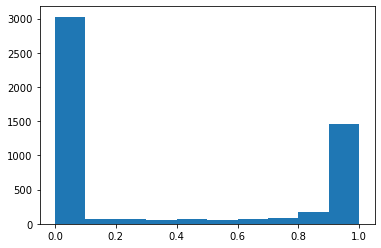

In [9]:
plt.hist(XPP_tr[Y_tr==0][:,0])

(array([1299.,   74.,   57.,   70.,   52.,   60.,   97.,  107.,  202.,
        3112.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

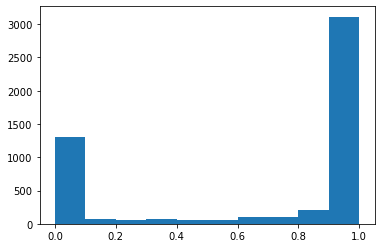

In [10]:
plt.hist(XPP_tr[Y_tr==1][:,0])

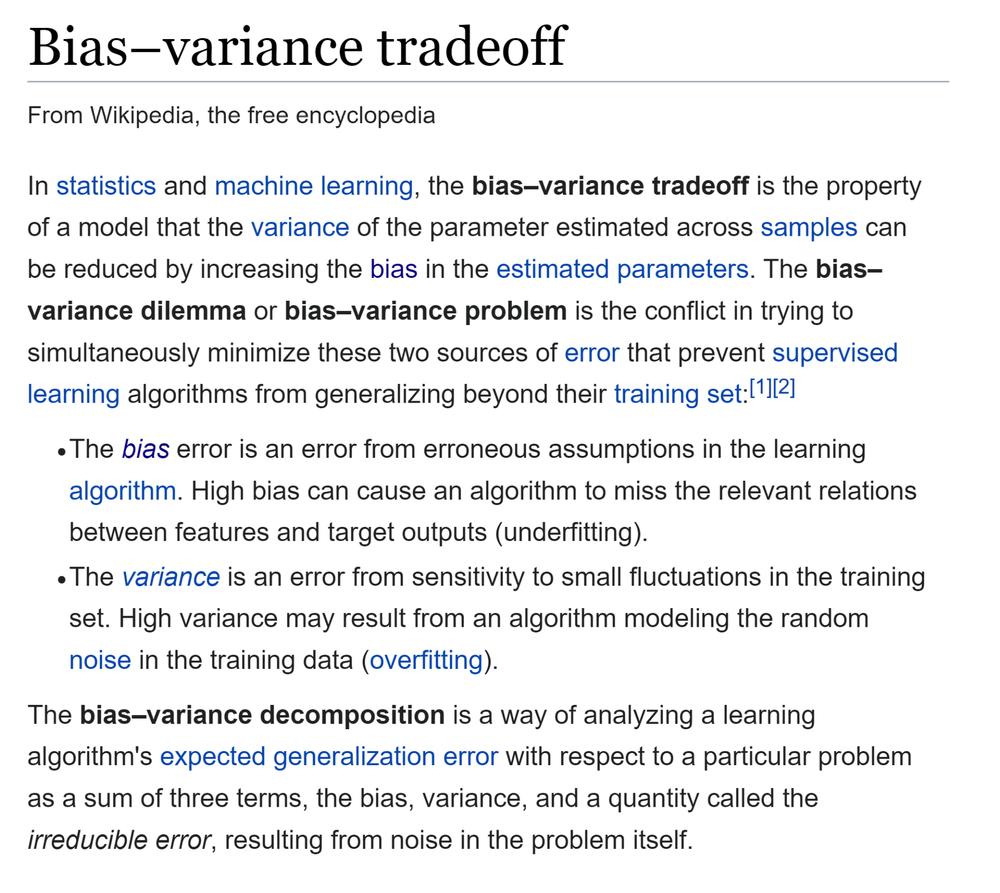
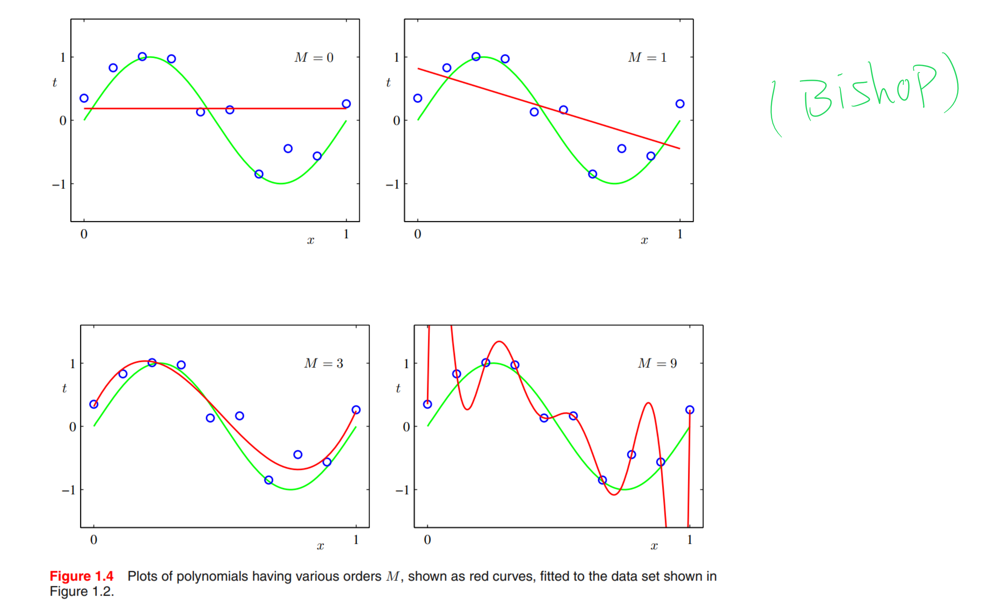
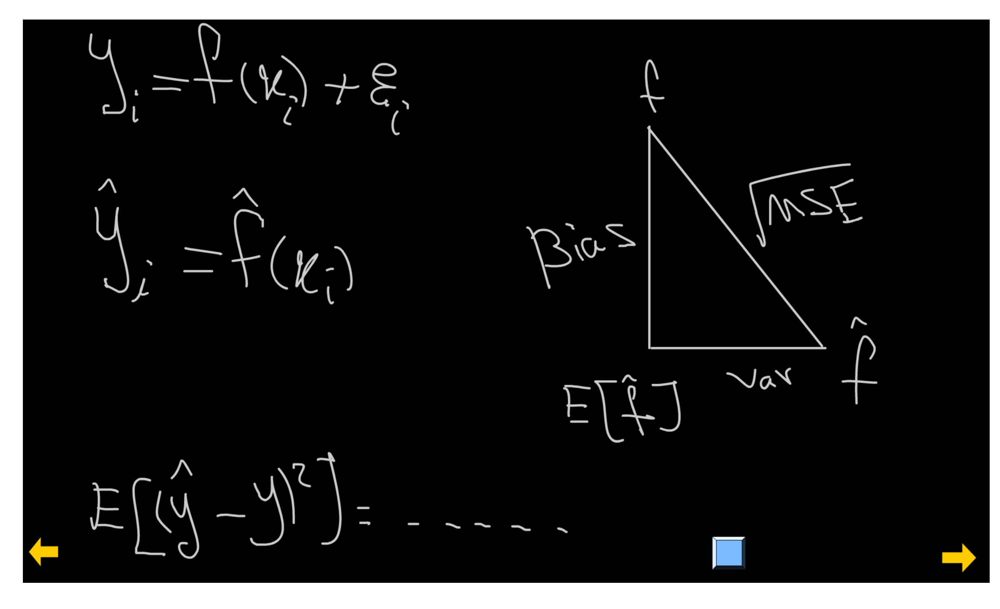
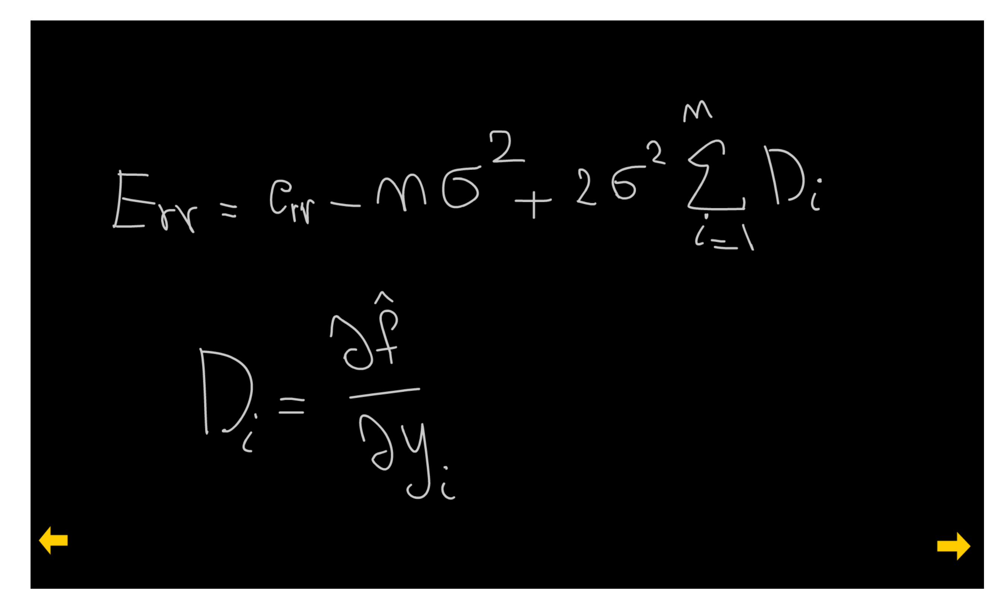
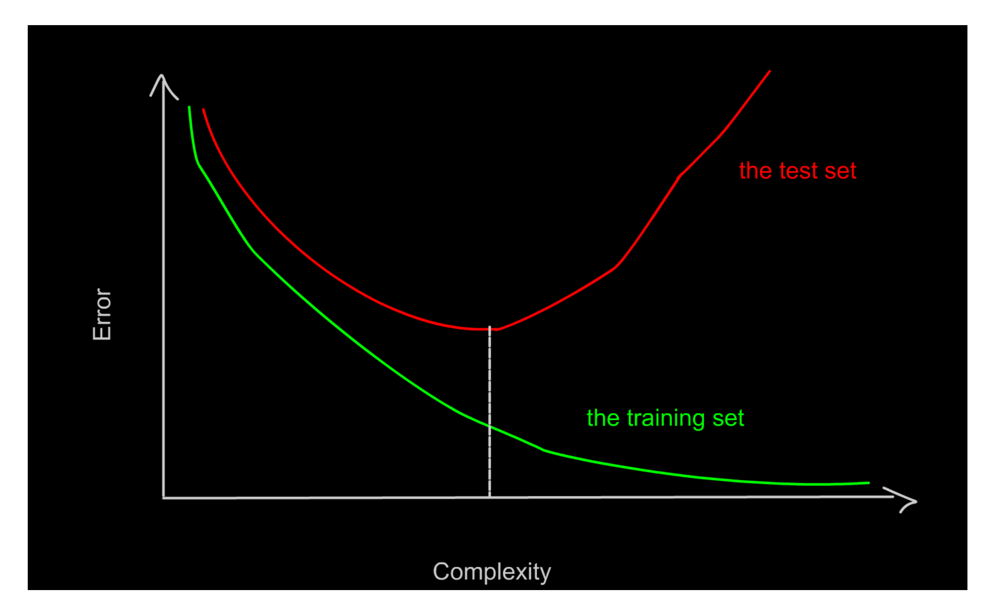
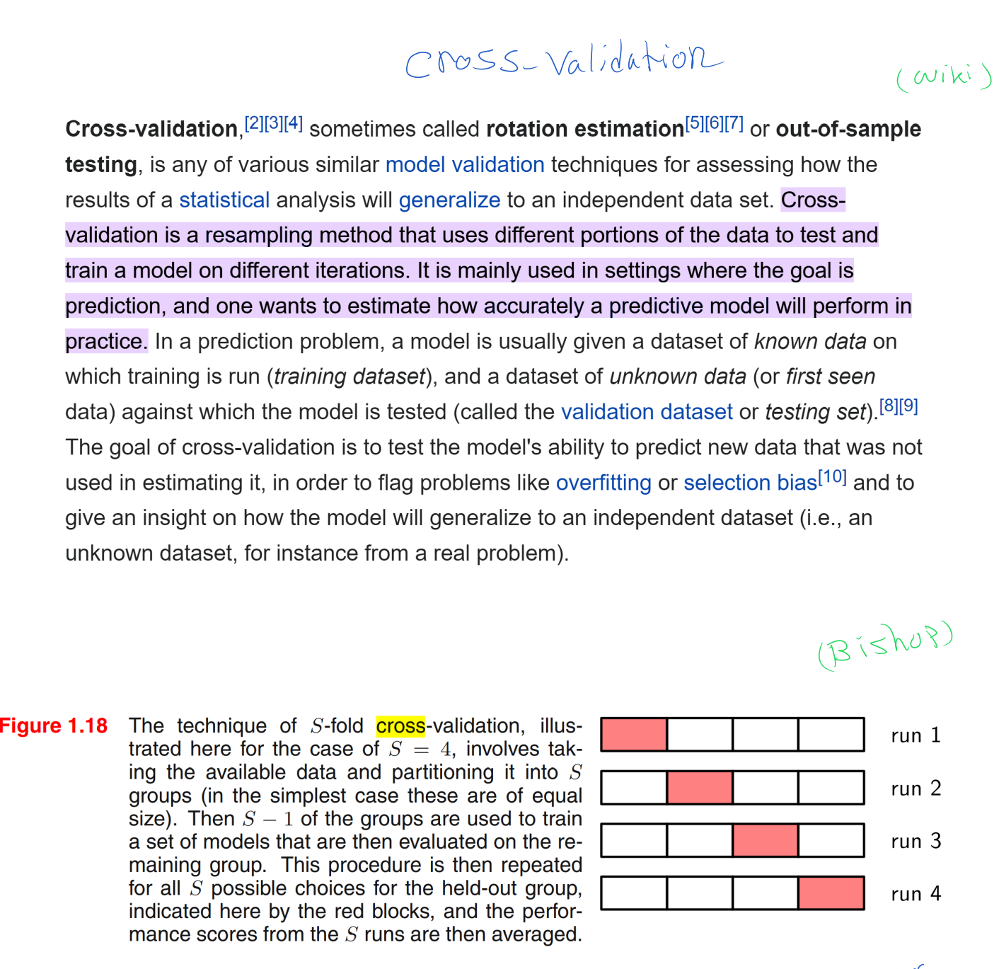
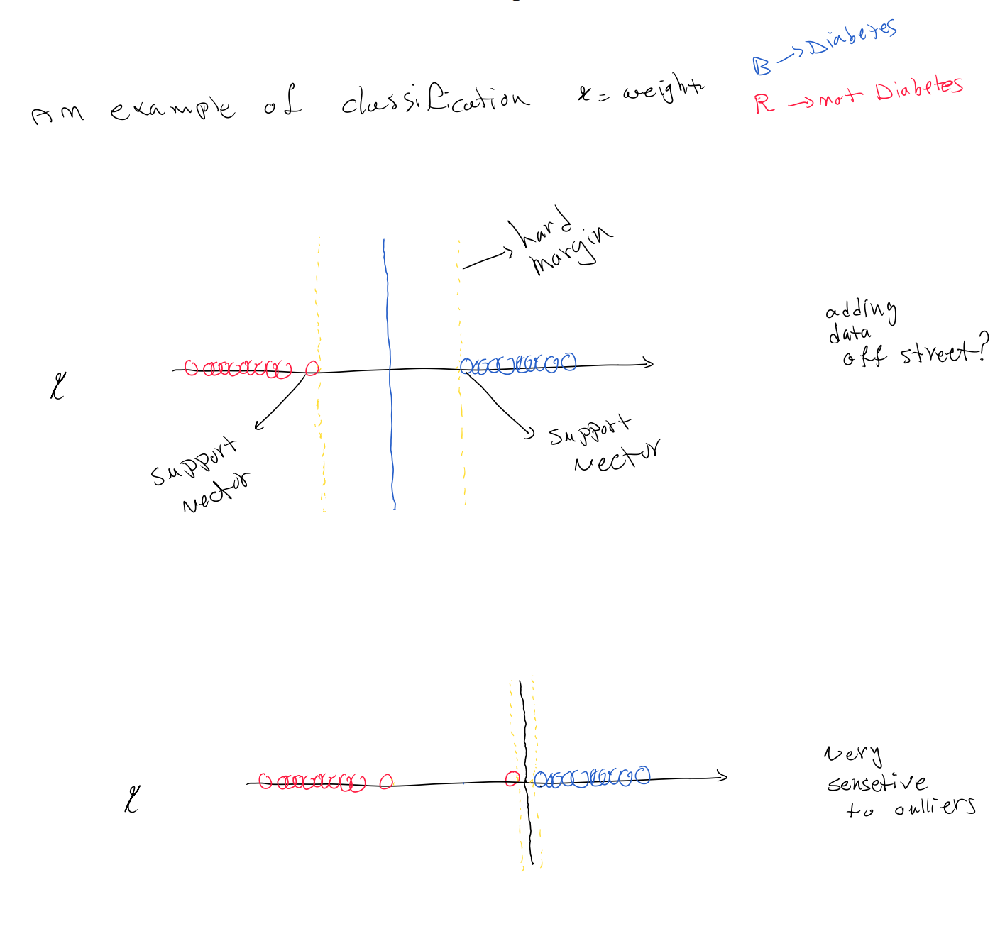
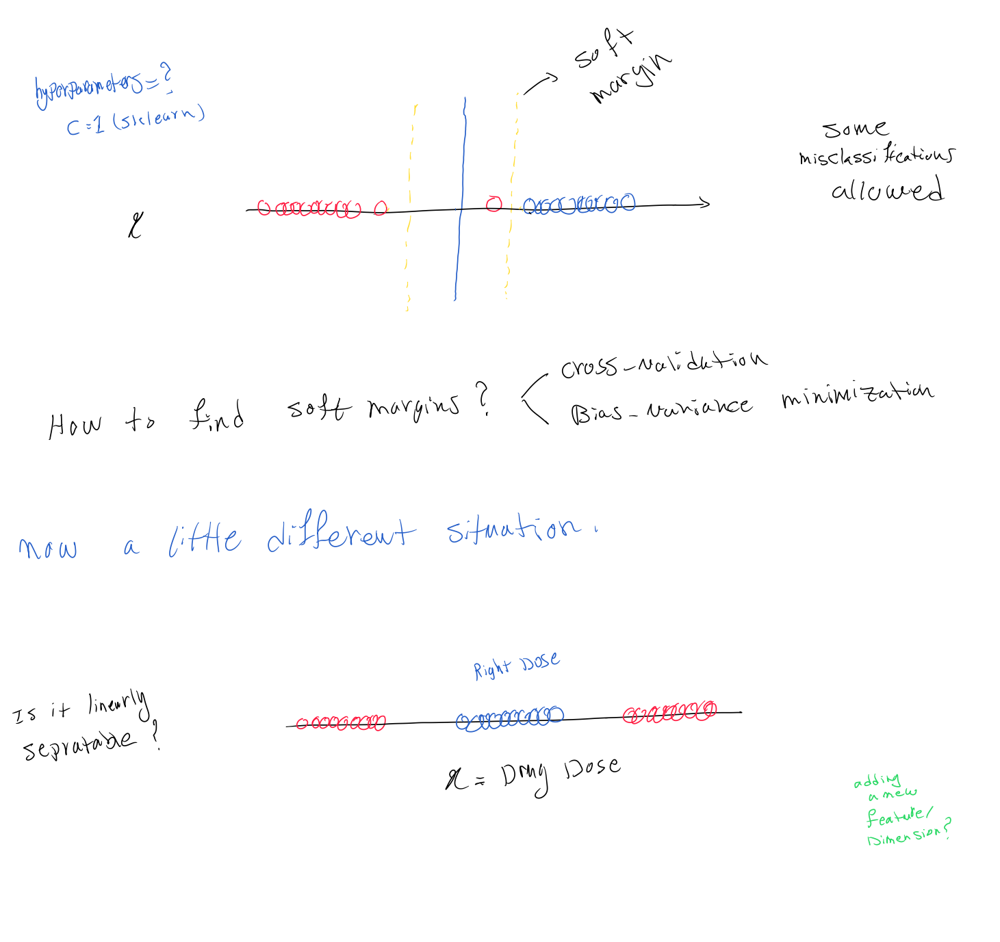
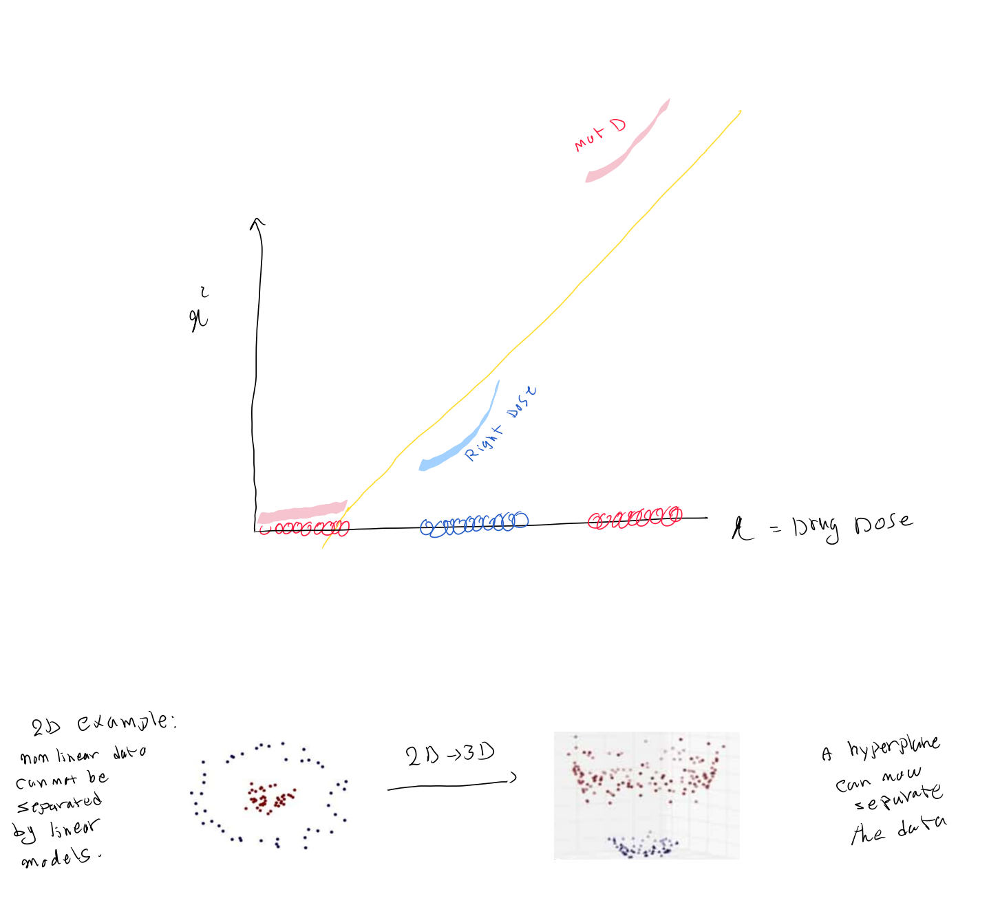
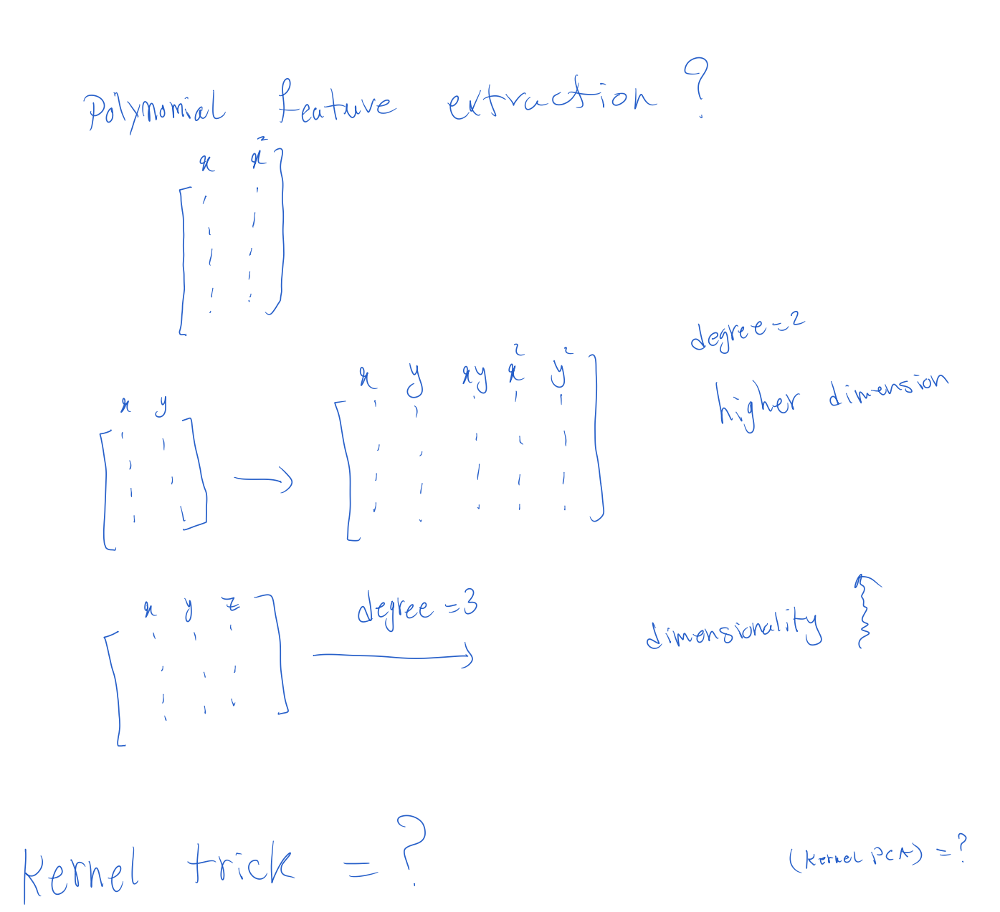

# Without Kernel trick ---------------------------------------------
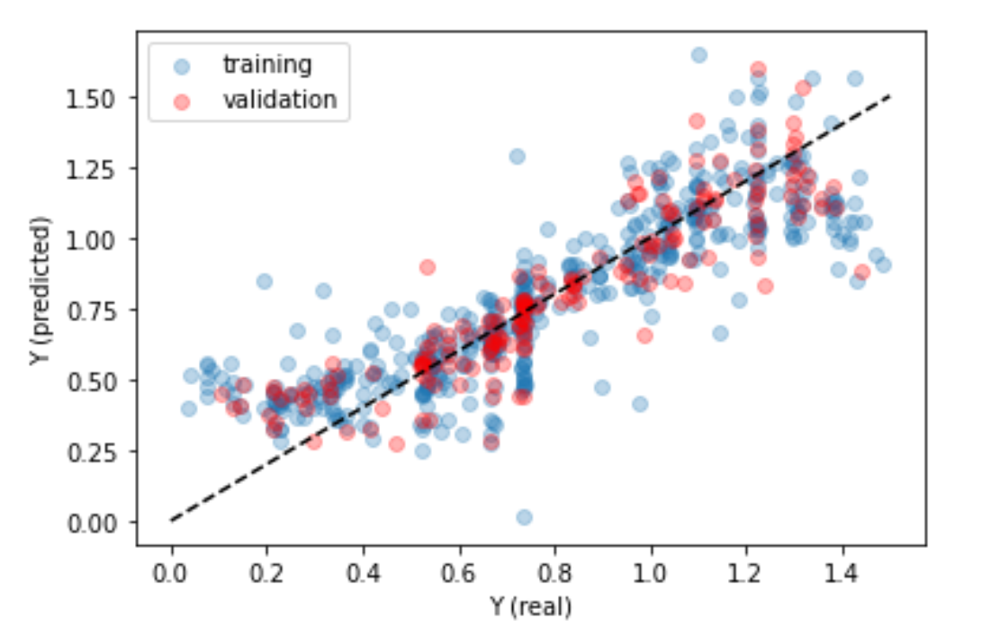
# With Kernel trick -----------------------------------------------
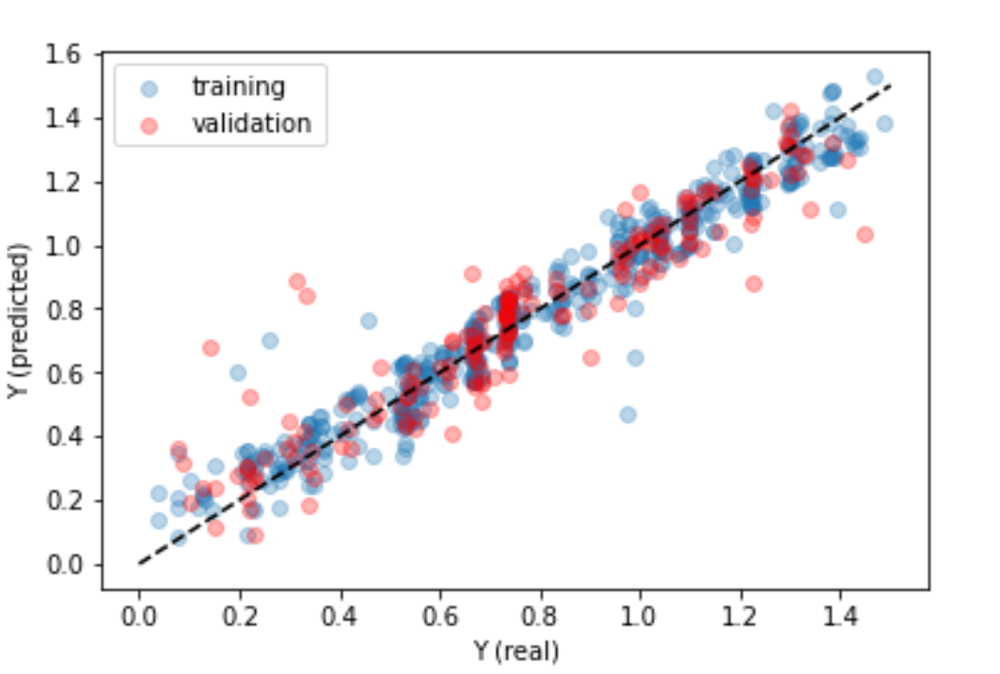

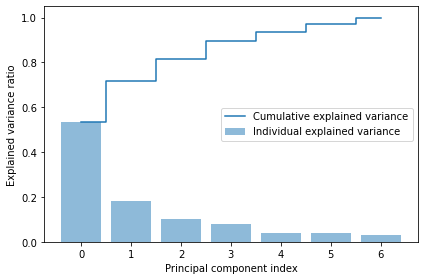

In [11]:
inp_red= np.load('inp_redshift.npy')
tar_red=np.load('tar_redshift.npy')


from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
sc = MinMaxScaler()
sc.fit(inp_red)
inp_red_norm = sc.transform(inp_red)

pca = PCA()
#
# Determine transformed features
#
inp_red_pca = pca.fit_transform(inp_red_norm)
#
# Determine explained variance using explained_variance_ration_ attribute
#
exp_var_pca = pca.explained_variance_ratio_
#
# Cumulative sum of eigenvalues; This will be used to create step plot
# for visualizing the variance explained by each principal component.
#
cum_sum_eigenvalues = np.cumsum(exp_var_pca)
#
# Create the visualization plot
#
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

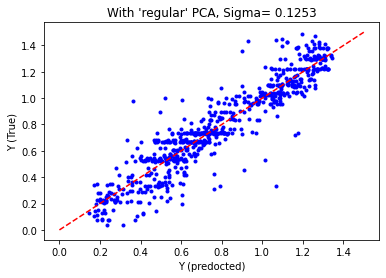

In [12]:
pca = PCA(n_components=3)
inp_red_pca = pca.fit_transform(inp_red_norm)

from sklearn.neighbors import KNeighborsRegressor  # choose your model

model = KNeighborsRegressor(n_neighbors=5)  # set the hyperparameters

model.fit(inp_red_pca,tar_red)  # train it

Y_pre = model.predict(inp_red_pca)

plt.plot(Y_pre,tar_red,'.b')
plt.xlabel('Y (predocted)')
plt.ylabel('Y (True)')
plt.plot([0,1.5],[0,1.5],'--r')

plt.title('With \'regular\' PCA, Sigma= '+ str(np.round(np.std(Y_pre-tar_red),4)))


plt.show()


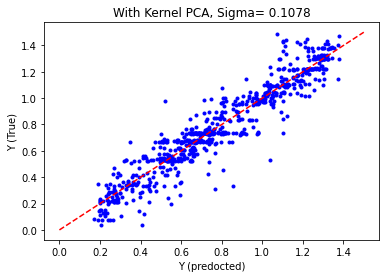

In [13]:
from sklearn.decomposition import KernelPCA
rbf_pca = KernelPCA(n_components = 3, kernel="rbf", gamma=10)

X_reduced_kpca = rbf_pca.fit_transform(inp_red_norm)

from sklearn.neighbors import KNeighborsRegressor  # choose your model

model = KNeighborsRegressor(n_neighbors=5)  # set the hyperparameters

model.fit(X_reduced_kpca,tar_red)  # train it

Y_pre = model.predict(X_reduced_kpca)

plt.plot(Y_pre,tar_red,'.b')
plt.xlabel('Y (predocted)')
plt.ylabel('Y (True)')
plt.plot([0,1.5],[0,1.5],'--r')

plt.title('With Kernel PCA, Sigma= '+ str(np.round(np.std(Y_pre-tar_red),4)))
plt.show()


# More about ANNs  ------------------------
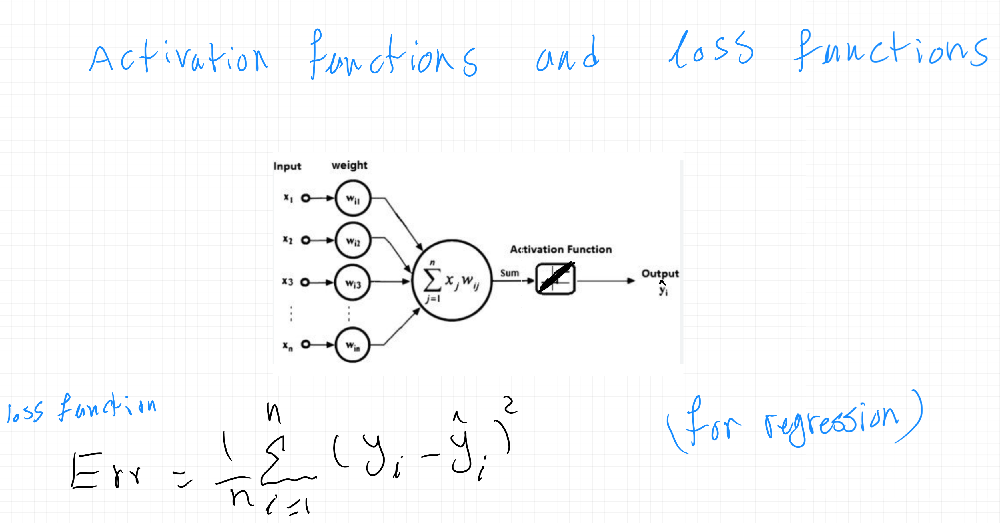
# If classification ------------------------------------------------------------
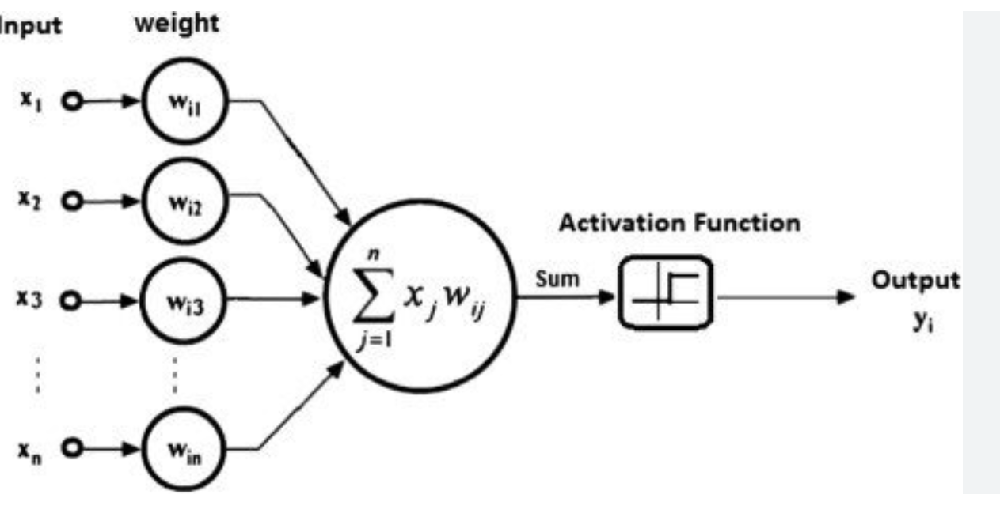
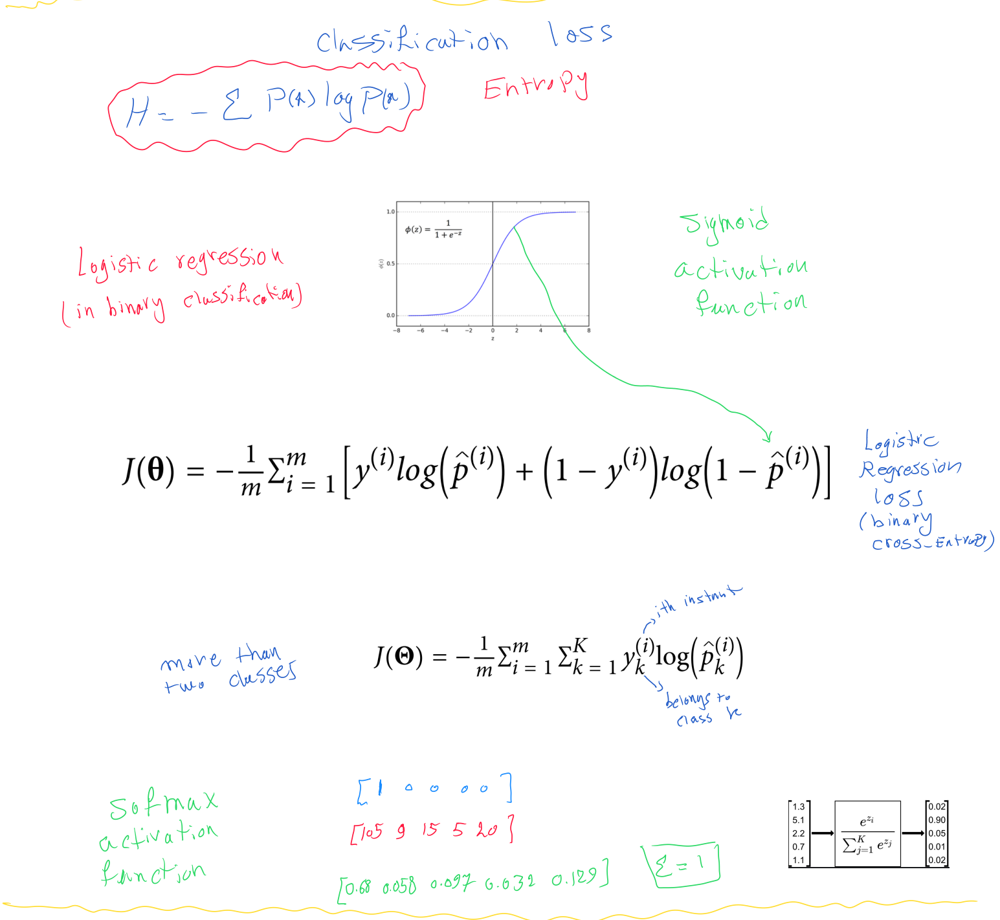


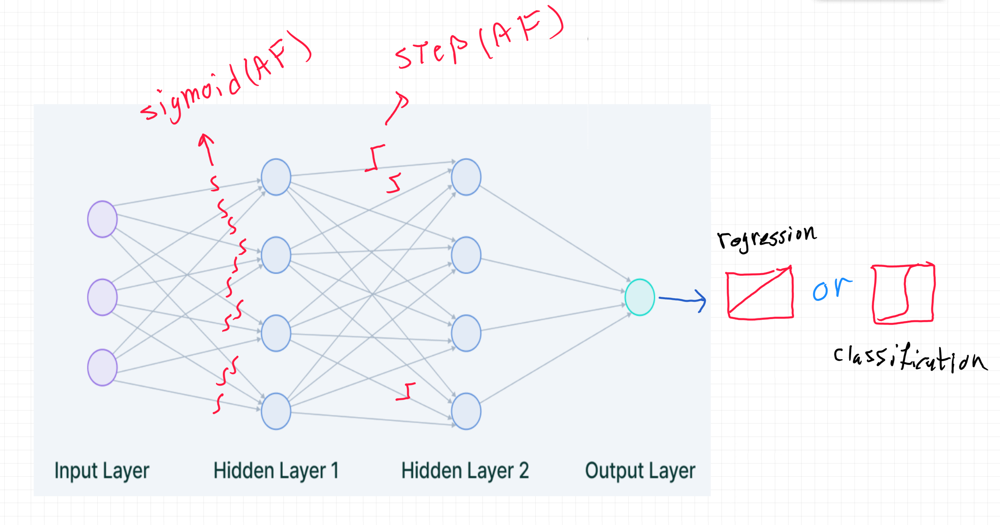

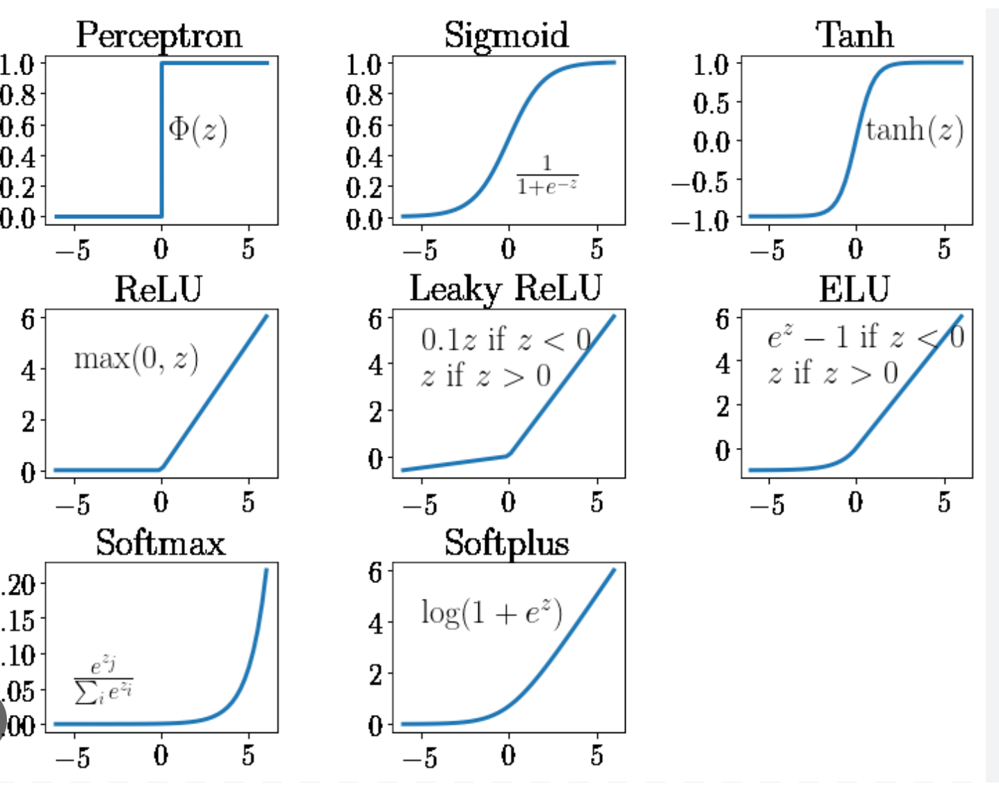

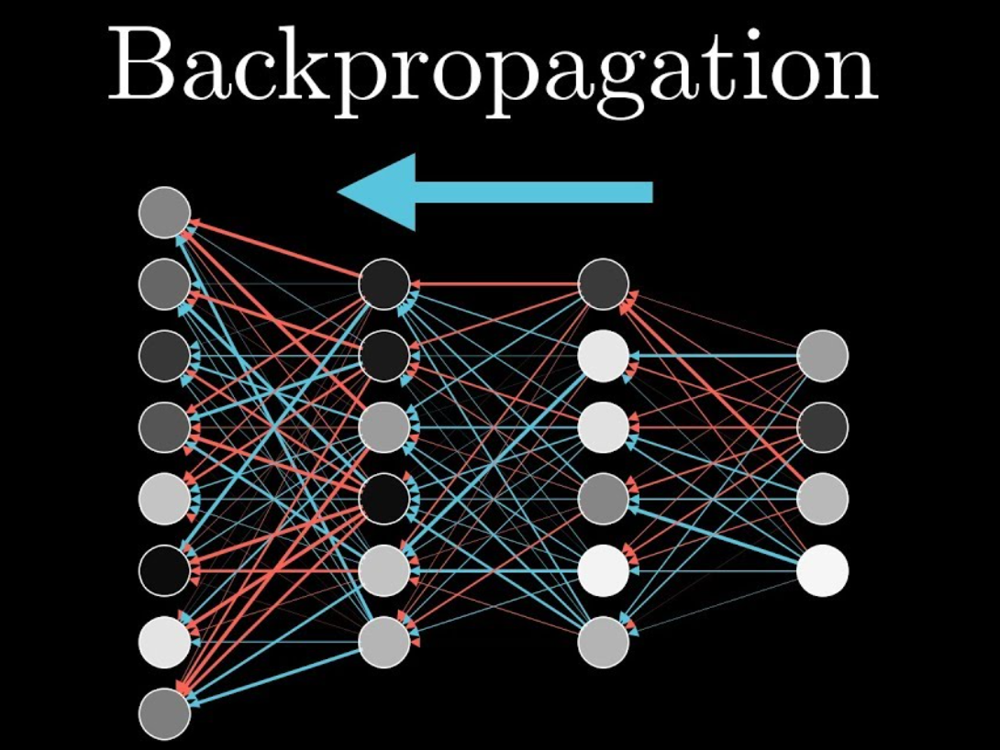
...

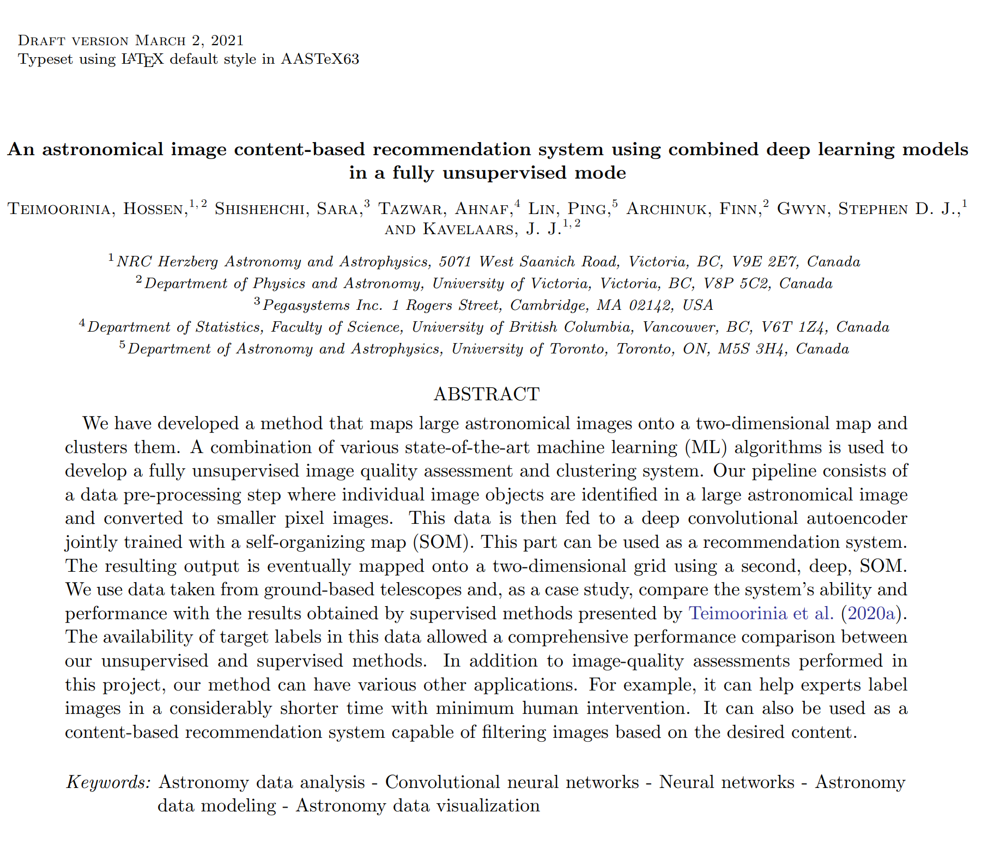
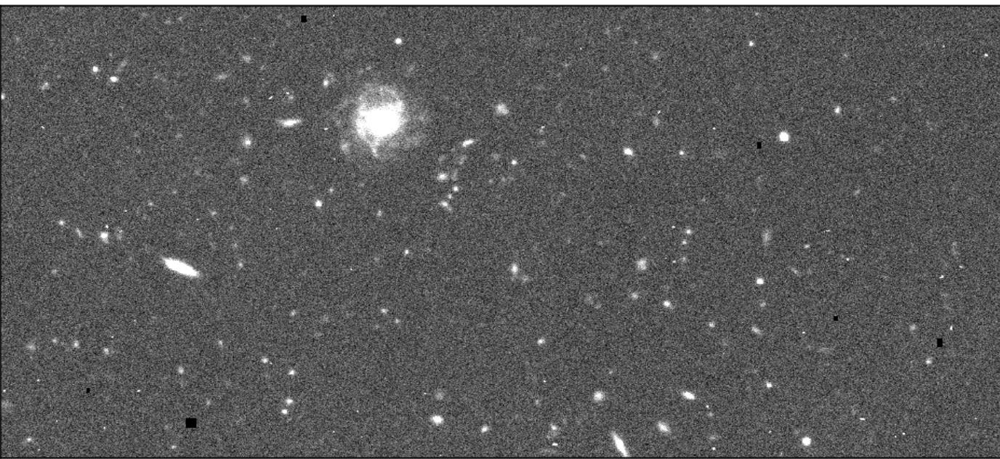
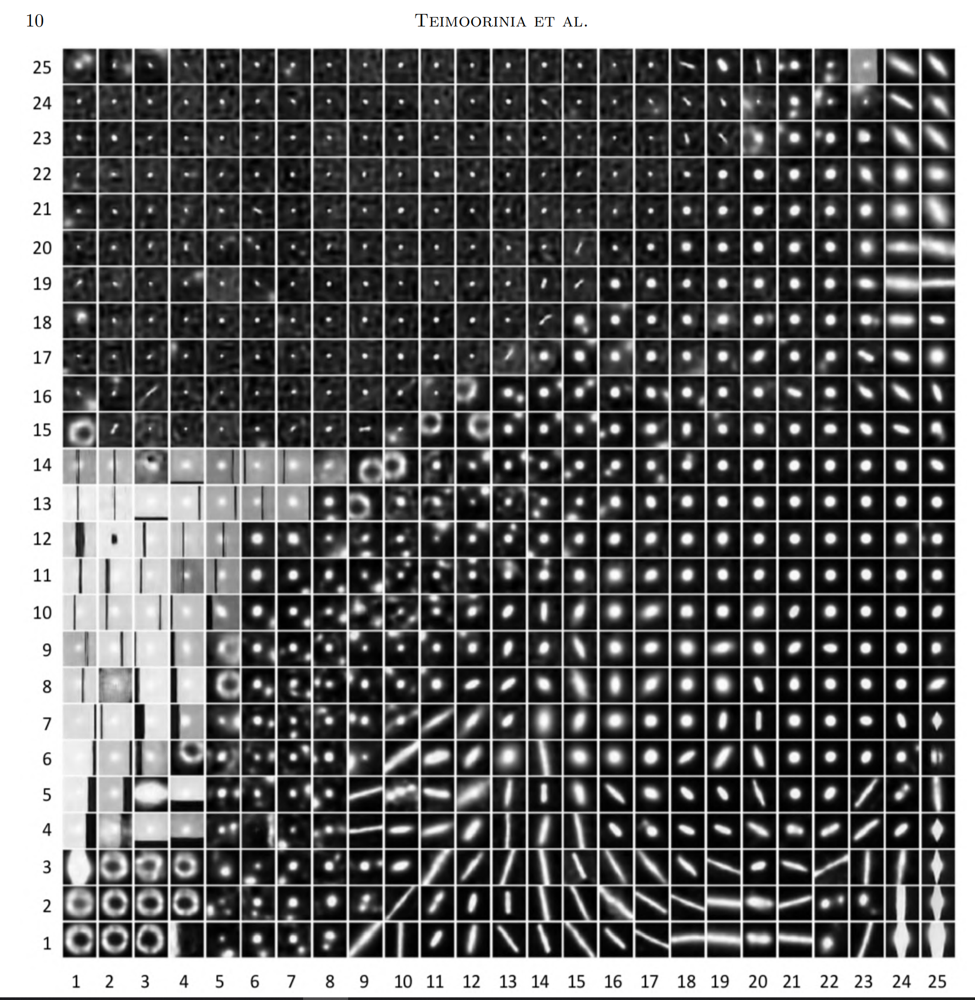
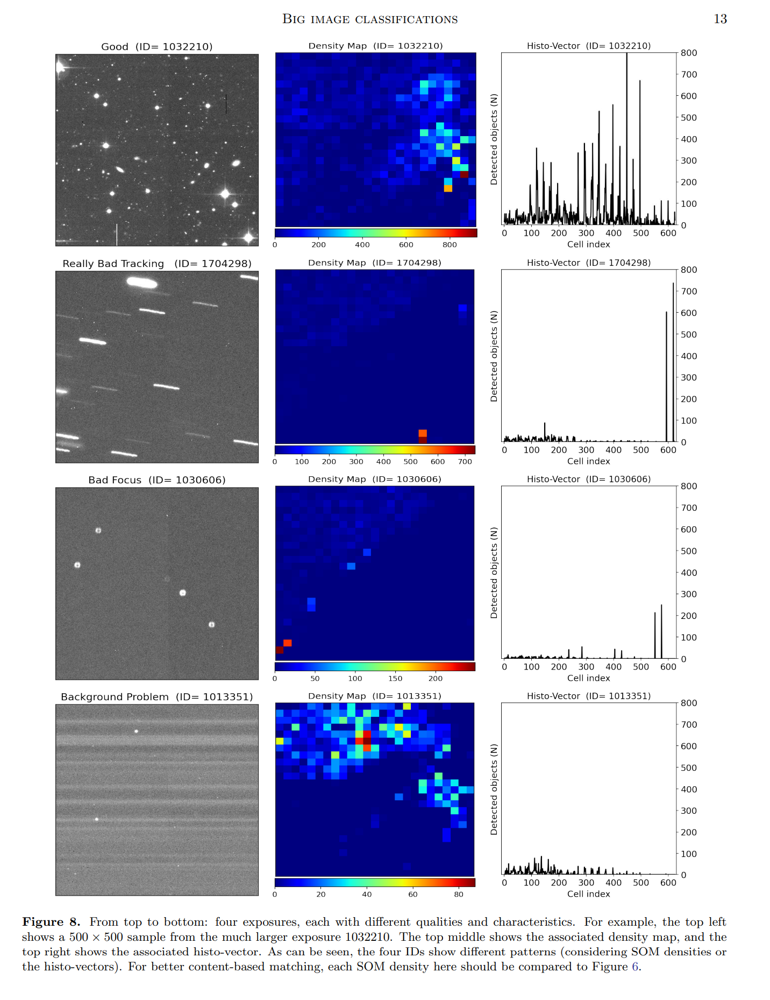
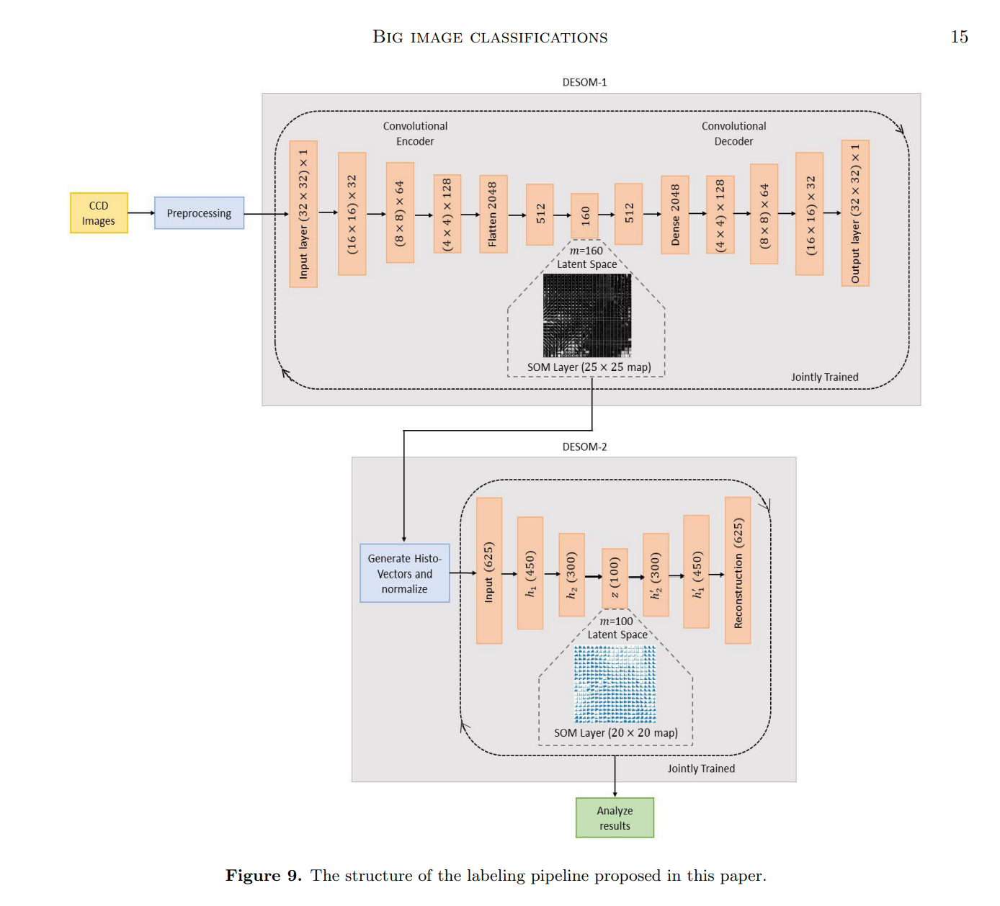